In [1]:
from datetime import datetime
tickers_list = ['USDJPY=X', 'USDCHF=X', 'GC=F', 'EURUSD=X', 'BMW.DE']

download_path = './downloads'
start_time_for_gathering_data = '2022-08-10'
end_time_for_gathering_data = datetime.today().strftime('%Y-%m-%d')
interval_for_gathering_time = '1h'

In [2]:
import pandas as pd
import plotly.graph_objects as go
import yfinance as yf
from plotly.subplots import make_subplots
from utils.utility import path_exists, apply_total_signal, pointpos

import pandas_ta as ta

def fetch_data():
    ilist = []
    is_processed = False;
    for ticker in tickers_list:
        clean_ticker = ticker.replace('=X', '')
        clean_ticker = clean_ticker.replace('=F', '')
        file = path_exists(download_path, clean_ticker, '.csv')
        if file:
            ilist.append({clean_ticker: pd.read_csv(file)})
            is_processed = True

    if len(ilist) > 0:
        return ilist, is_processed

    df = yf.download(tickers=tickers_list, start=start_time_for_gathering_data, end=end_time_for_gathering_data,
                     interval=interval_for_gathering_time, group_by='ticker')

    df_usdjpy_candle_1d_2000_01_01_to_2024_08_04 = df[tickers_list[0]]
    df_usdchf_candle_1d_2000_01_01_to_2024_08_04 = df[tickers_list[1]]
    df_gold_candle_1d_2000_01_01_to_2024_08_04 = df[tickers_list[2]]
    df_eurusd_candle_1d_2000_01_01_to_2024_08_04 = df[tickers_list[3]]
    df_bmw_de_candle_1d_2000_01_01_to_2024_08_04 = df[tickers_list[4]]

    df_gold_candle_1d_2000_01_01_to_2024_08_04.to_csv(
        download_path + '/GC_candle_' + interval_for_gathering_time + start_time_for_gathering_data + '_TO_' + end_time_for_gathering_data + '.csv',
        mode='w+')

    df_usdchf_candle_1d_2000_01_01_to_2024_08_04.to_csv(
        download_path + '/USDCHF_candle_' + interval_for_gathering_time + start_time_for_gathering_data + '_TO_' + end_time_for_gathering_data + '.csv',
        mode='w+')

    df_eurusd_candle_1d_2000_01_01_to_2024_08_04.to_csv(
        download_path + '/EURUSD_candle_' + interval_for_gathering_time + start_time_for_gathering_data + '_TO_' + end_time_for_gathering_data + '.csv',
        mode='w+')

    df_usdjpy_candle_1d_2000_01_01_to_2024_08_04.to_csv(
        download_path + '/USDJPY_candle_' + interval_for_gathering_time + start_time_for_gathering_data + '_TO_' + end_time_for_gathering_data + '.csv',
        mode='w+')

    df_bmw_de_candle_1d_2000_01_01_to_2024_08_04.to_csv(
        download_path + '/BMW.DE_candle_' + interval_for_gathering_time + start_time_for_gathering_data + '_TO_' + end_time_for_gathering_data + '.csv',
        mode='w+')

    return [{'EURUSD': df_eurusd_candle_1d_2000_01_01_to_2024_08_04},
            {'GC': df_gold_candle_1d_2000_01_01_to_2024_08_04},
            {'USDCHF': df_usdchf_candle_1d_2000_01_01_to_2024_08_04},
            {'BMW.DE': df_bmw_de_candle_1d_2000_01_01_to_2024_08_04},
            {'USDJPY': df_usdjpy_candle_1d_2000_01_01_to_2024_08_04}], is_processed


def calc_primary_indicator(df):
    df = df[df.High != df.Low]

    df.ta.bbands(append=True, length=30, std=2)
    df.ta.rsi(append=True, length=14)
    df["atr"] = ta.atr(low=df.Low, close=df.Close, high=df.High, length=14)

    df.rename(columns={
        'BBL_30_2.0': 'bbl', 'BBM_30_2.0': 'bbm', 'BBU_30_2.0': 'bbh', 'RSI_14': 'rsi'
    }, inplace=True)

    # Calculate Bollinger Bands Width
    df['bb_width'] = (df['bbh'] - df['bbl']) / df['bbm']

    df.rename(
        columns={'bbl': 'BBL', 'bb_width': 'BB_WIDTH', 'bbm': 'BBM', 'bbh': 'BBH', 'rsi': 'RSI'},
        inplace=True)

    return df


def plot_chart_with_indicators(df, label, st):
    dfpl = df
    fig = make_subplots(rows=2, cols=1)
    fig.add_trace(go.Candlestick(x=dfpl.Date,
                                 open=dfpl['Open'],
                                 high=dfpl['High'],
                                 low=dfpl['Low'],
                                 close=dfpl['Close']),
                  row=1, col=1)

    fig.add_trace(go.Scatter(x=dfpl.Date, y=dfpl['BBL'],
                             line=dict(color='blue', width=1),
                             name="BBL"),
                  row=1, col=1)
    fig.add_trace(go.Scatter(x=dfpl.Date, y=dfpl['BBH'],
                             line=dict(color='green', width=1),
                             name="BBU"),
                  row=1, col=1)

    # Add markers for trade entry points on the same subplot
    fig.add_trace(go.Scatter(x=dfpl.Date, y=dfpl['pointpos'], mode="markers",
                             marker=dict(size=8, color="MediumPurple"),
                             name="entry"),
                  row=1, col=1)

    fig.add_trace(go.Scatter(x=dfpl.Date, y=dfpl['RSI'],
                             line=dict(color='green', width=2),
                             name="RSI"),
                  row=2, col=1)

    fig.update_layout(width=1800, height=800, sliders=[], title_text=label)

    fig.show()

In [4]:
fetched_data_list, is_processed = fetch_data()
df_list = []
ticker_list = []
for item in fetched_data_list:
    df_list.append(pd.DataFrame(list(item.items())[0][1]))
    ticker_list.append(list(item.items())[0][0])

if not is_processed:
    for index in range(0, len(df_list)):
        df_list[index] = calc_primary_indicator(df_list[index])
        df_list[index] = df_list[index].round(4)
        df_list[index].reset_index(inplace=True)
        df_list[index].rename(columns={'Datetime' : 'Date'}, inplace=True)
        df_list[index].Date = pd.to_datetime(df_list[index].Date, format='%Y-%m-%d %H:%M:%S').dt.tz_localize(None) 
        df_list[index].set_index('Date', inplace=True)
        df_list[index].to_csv(download_path + "/" + ticker_list[index] + '.csv')

total_signal_length = 0
final_df_list = []
for index in range(0, len(df_list)):
    df = df_list[index]
    df.ta.bbands(append=True, length=30, std=2)
    df.ta.rsi(append=True, length=14)
    df["atr"] = ta.atr(low=df.Low, close=df.Close, high=df.High, length=14)
    df.rename(columns={
        'BBL_30_2.0': 'bbl', 'BBM_30_2.0': 'bbm', 'BBU_30_2.0': 'bbh', 'RSI_14': 'rsi'
    }, inplace=True)

    # Calculate Bollinger Bands Width
    df['bb_width'] = (df['bbh'] - df['bbl']) / df['bbm']
    apply_total_signal(df=df, rsi_threshold_low=30, rsi_threshold_high=70, bb_width_threshold=0.001)
    df['pointpos'] = df.apply(lambda row: pointpos(row), axis=1)
    total_signal_length += len(df[df['TotalSignal'] != 0])
    final_df_list.append(df)
    print('Ticker : ' + ticker_list[index] + '  list index is : ' + str(index) )
    # print(df[df['TotalSignal'] != 0 ][['Date','Open', 'High', 'Low','Close', 'TotalSignal', 'pointpos']].head())

    plot_chart_with_indicators(df, ticker_list[index], st=500)

print("Total Signal Count Is: {}".format(total_signal_length))


Ticker : USDJPY  list index is : 
0


Ticker : USDCHF  list index is : 
1


Ticker : GC  list index is : 
2


Ticker : EURUSD  list index is : 
3


Ticker : BMW.DE  list index is : 
4


Total Signal Count Is: 211


In [30]:
from backtesting import Strategy
from backtesting import Backtest

dfopt=  final_df_list[0]

dfopt = dfopt[dfopt['Open'].notna()]
dfopt = dfopt[0:10000]
def SIGNAL():
    return dfopt.TotalSignal

class MyStrat(Strategy):
    mysize = 0.2
    slcoef = 4
    TPcoef = 2

    def init(self):
        super().init()
        self.signal1 = self.I(SIGNAL)

    def next(self):
        super().next()
        slatr = self.slcoef*self.data.atr[-1]
        tpatr = self.TPcoef*self.data.atr[-1]

        if self.signal1==2 and len(self.trades)==0:
            sl1 = self.data.Close[-1] - slatr
            tp1 = self.data.Close[-1] + tpatr
            self.buy(sl=sl1, tp=tp1, size=self.mysize)

        if self.signal1==1 and len(self.trades)==0:
            sl1 = self.data.Close[-1] + slatr
            tp1 = self.data.Close[-1] - tpatr
            self.sell(sl=sl1, tp=tp1, size=self.mysize)

bt = Backtest(dfopt, MyStrat, cash=10000, margin=1/10, commission=0.001) #0.0002
stats, heatmap = bt.optimize(slcoef=[i/10 for i in range(10, 16)],
                             TPcoef=[i/10 for i in range(10, 21)],
                             maximize='Return [%]', max_tries=300,
                             random_state=0,
                             return_heatmap=True)
stats

E:\Project\Farabi\StockMarketData\venv\Lib\site-packages\backtesting\backtesting.py:1054: FutureWarning:

Index.is_numeric is deprecated. Use pandas.api.types.is_any_real_numeric_dtype instead

C:\Users\S.Eyvazi\AppData\Local\Temp\ipykernel_14960\2545091928.py:35: UserWarning:

Data index is not datetime. Assuming simple periods, but `pd.DateTimeIndex` is advised.



  0%|          | 0/17 [00:00<?, ?it/s]

ValueError: Short orders require: TP (148.72921463708613) < LIMIT (148.725126) < SL (149.01878536291386)

In [9]:
idf = final_df_list[0]

idf['NextClose'] = idf['Close'].shift(-1) - idf['Close']

idf

,Date,Open,High,Low,Close,Adj Close,Volume,BBL,BBM,BBH,...,atr,BB_WIDTH,bbl,bbm,bbh,rsi,bb_width,TotalSignal,pointpos,NextClose
0,2022-08-09 23:00:00,135.107,135.199,135.07,135.190,135.190,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0.023
1,2022-08-10 00:00:00,135.198,135.303,135.08,135.213,135.213,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,-0.154
2,2022-08-10 01:00:00,135.212,135.243,135.02,135.059,135.059,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,-0.067
3,2022-08-10 02:00:00,135.057,135.104,134.95,134.992,134.992,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,-0.041
4,2022-08-10 03:00:00,134.997,135.042,134.89,134.951,134.951,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0.036
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12425,2024-08-05 23:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.846191,NaN,NaN,NaN,NaN,56.39975,NaN,0,NaN,NaN
12426,2024-08-06 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.846191,NaN,NaN,NaN,NaN,56.39975,NaN,0,NaN,NaN
12427,2024-08-06 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.846191,NaN,NaN,NaN,NaN,56.39975,NaN,0,NaN,NaN
12428,2024-08-06 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.846191,NaN,NaN,NaN,NaN,56.39975,NaN,0,NaN,NaN


In [10]:
import numpy as np

conditions = [idf['NextClose'] < 0, idf['NextClose'] == 0, idf['NextClose'] > 0 ]
choices = [0, 1, 2]
idf['Target'] = np.select(conditions, choices)

In [11]:
idf[idf.Target == 1]

,Date,Open,High,Low,Close,Adj Close,Volume,BBL,BBM,BBH,...,BB_WIDTH,bbl,bbm,bbh,rsi,bb_width,TotalSignal,pointpos,NextClose,Target
305,2022-08-26 16:00:00,137.074,137.370,137.010,137.332,137.332,0.0,136.2800,136.7612,137.2424,...,0.0070,136.280002,136.761200,137.242398,62.504382,0.007037,0,NaN,0.0,1
320,2022-08-29 07:00:00,138.789,138.906,138.610,138.700,138.700,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,69.743466,NaN,0,NaN,0.0,1
584,2022-09-13 07:00:00,142.345,142.482,142.180,142.251,142.251,0.0,142.1362,142.6334,143.1307,...,0.0070,142.136205,142.633433,143.130662,40.028075,0.006972,0,NaN,0.0,1
903,2022-09-30 15:00:00,144.744,144.794,144.560,144.714,144.714,0.0,144.2873,144.5446,144.8018,...,0.0036,144.287311,144.544567,144.801823,57.363039,0.003560,0,NaN,0.0,1
990,2022-10-06 06:00:00,144.521,144.604,144.460,144.586,144.586,0.0,144.1125,144.4797,144.8469,...,0.0051,144.112531,144.479700,144.846869,53.147359,0.005083,0,NaN,0.0,1
1086,2022-10-12 06:00:00,146.207,146.261,146.060,146.170,146.170,0.0,145.3909,145.8265,146.2621,...,0.0060,145.390888,145.826500,146.262112,67.029250,0.005974,0,NaN,0.0,1
1110,2022-10-13 06:00:00,146.880,146.901,146.750,146.834,146.834,0.0,146.0736,146.6387,147.2039,...,0.0077,146.073587,146.638733,147.203880,63.721179,0.007708,0,NaN,0.0,1
1204,2022-10-19 04:00:00,149.202,149.305,149.151,149.296,149.296,0.0,148.7794,149.0829,149.3864,...,0.0041,148.779378,149.082900,149.386422,62.333517,0.004072,0,NaN,0.0,1
1984,2022-12-02 14:00:00,135.399,135.742,135.140,135.471,135.471,0.0,133.8234,135.2585,136.6936,...,0.0212,133.823364,135.258500,136.693636,53.800927,0.021221,0,NaN,0.0,1
2088,2022-12-08 22:00:00,136.652,136.681,136.590,136.619,136.619,0.0,136.2468,136.6516,137.0564,...,0.0059,136.246819,136.651633,137.056448,47.011539,0.005925,0,NaN,0.0,1


Mean Squared Error Test : 1.973
Mean Squared Error Train : 0.434
Accuracy For Test : 0.504


<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

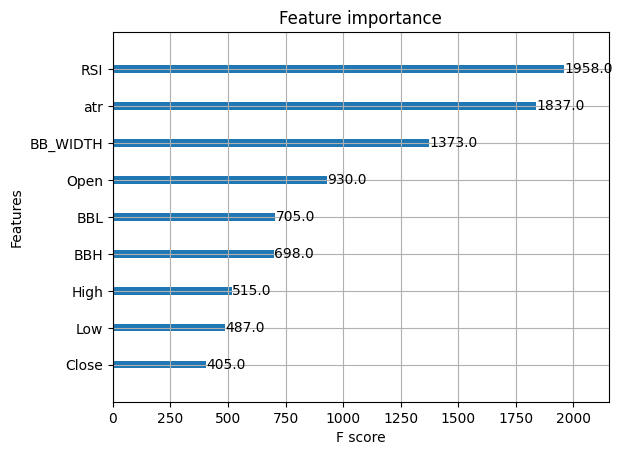

In [12]:
from xgboost import XGBClassifier, plot_importance
from sklearn.metrics import auc, accuracy_score, confusion_matrix, mean_squared_error, ConfusionMatrixDisplay

from sklearn.model_selection import train_test_split
attribute = ['Open', 'High', 'Low','Close','Volume' , 'RSI', 'BBL', 'BBH', 'BB_WIDTH', 'atr' ]
target = idf['Target']
data = idf[attribute]
X_train, X_test, y_train, y_test = train_test_split(data, target, test_size=.3)

# create model instance
bst = XGBClassifier()

# fit model
bst.fit(X_train, y_train)
# make predictions
y_pred = bst.predict(X_test)
predict_train = bst.predict(X_train)


mse=mean_squared_error(y_test, y_pred)
mse2=mean_squared_error(y_train, predict_train)

print('Mean Squared Error Test : {:.3f}'.format((mse)))
print('Mean Squared Error Train : {:.3f}'.format(mse2))

print('Accuracy For Test : {:.3f}'.format(accuracy_score(y_test, y_pred)))


plot_importance(bst)

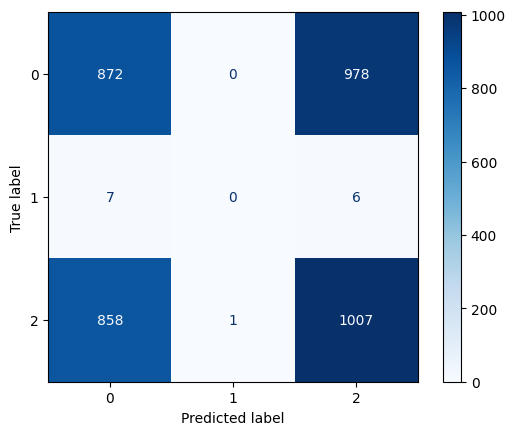

In [13]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
cm = confusion_matrix(y_test, y_pred)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=bst.classes_)

disp.plot(cmap=plt.cm.Blues)



In [17]:
dfopt

,Date,Open,High,Low,Close,Adj Close,Volume,BBL,BBM,BBH,...,BB_WIDTH,bbl,bbm,bbh,rsi,bb_width,TotalSignal,pointpos,NextClose,Target
0,2022-08-09 23:00:00,135.107,135.199,135.070,135.190,135.190,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0.023,2
1,2022-08-10 00:00:00,135.198,135.303,135.080,135.213,135.213,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,-0.154,0
2,2022-08-10 01:00:00,135.212,135.243,135.020,135.059,135.059,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,-0.067,0
3,2022-08-10 02:00:00,135.057,135.104,134.950,134.992,134.992,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,-0.041,0
4,2022-08-10 03:00:00,134.997,135.042,134.890,134.951,134.951,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,0.036,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10159,2024-03-26 12:00:00,151.388,151.474,151.346,151.452,151.452,0.0,151.2179,151.3602,151.5025,...,0.0019,151.217878,151.360167,151.502456,58.286396,0.001880,0,NaN,-0.047,0
10160,2024-03-26 13:00:00,151.449,151.467,151.372,151.405,151.405,0.0,151.2204,151.3629,151.5054,...,0.0019,151.220422,151.362900,151.505378,54.291484,0.001883,0,NaN,-0.020,0
10161,2024-03-26 14:00:00,151.404,151.452,151.296,151.385,151.385,0.0,151.2212,151.3639,151.5065,...,0.0019,151.221195,151.363867,151.506538,52.638162,0.001885,0,NaN,0.198,2
10162,2024-03-26 15:00:00,151.385,151.603,151.368,151.583,151.583,0.0,151.2074,151.3700,151.5326,...,0.0021,151.207379,151.369967,151.532554,64.246383,0.002148,0,NaN,-0.063,0
